In [72]:
import math
import seaborn as sns
from geopy.distance import geodesic
import geopandas as gpd
import matplotlib.pyplot as plt
import srtm 
import plotly.express as px
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt

pd.set_option('display.max_columns',50)
pd.set_option('display.max_rows',70)

In [73]:
train = pd.read_csv('Train.csv')
test = pd.read_csv('Test.csv')
ss = pd.read_csv('SampleSubmission.csv')

In [74]:
test.isna().sum()

ID_Zindi                 0
Date                     0
ID                       0
LAT                      0
LON                      0
Precipitation            0
LST                   2981
AAI                    868
CloudFraction          868
NO2_strat              868
NO2_total              868
NO2_trop              2578
TropopausePressure     868
dtype: int64

In [75]:
original_train = train.copy()

In [76]:
train[train['GT_NO2'] > 100]['ID'].value_counts()

ID
X5504     43
X5547     28
X5507     28
X5532     28
X5517     23
X5531     20
X5542     14
X9877     12
X10279    10
X5609      5
X9999      4
X17286     3
X5534      3
X5587      2
X5595      1
X6781      1
X5549      1
RO03       1
X5545      1
Name: count, dtype: int64

In [77]:
train = train.sort_values(by=['ID','Date'])

In [78]:
display(train.head(),test.head(),ss.head())

,ID_Zindi,Date,ID,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
0,ID_ENTGC7,1/1/19,PD01,45.601585,11.903551,0.000000,NaN,0.230527,0.559117,0.000024,0.000117,NaN,14440.82126,31.0
28835,ID_EWBJKR,1/1/20,PD01,45.601585,11.903551,0.000000,282.72,-1.278574,0.001923,0.000029,0.000129,0.000101,14443.81910,26.0
57749,ID_DY1J5C,1/1/21,PD01,45.601585,11.903551,6.616453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.0
21567,ID_NJ8THA,1/10/19,PD01,45.601585,11.903551,0.000000,299.98,-0.948916,0.380285,0.000043,0.000091,0.000034,13745.32280,14.0
50481,ID_P08I88,1/10/20,PD01,45.601585,11.903551,0.000000,NaN,-1.215117,0.535160,0.000043,0.000135,NaN,16711.77588,17.0


,ID_Zindi,Date,ID,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure
0,ID_2MYNQS,1/1/19,PD03,45.289376,11.642394,3.277529,NaN,-0.313361,0.771456,0.000024,0.000075,NaN,14440.02819
1,ID_P4U5WU,1/1/19,TV03,45.836941,12.510362,0.000000,NaN,-0.229512,0.398208,0.000023,0.000120,NaN,14434.04790
2,ID_U4KWPK,1/1/19,X5561,45.582894,8.842165,0.000000,282.98,-0.470822,0.153694,0.000023,0.000171,0.000148,14427.42478
3,ID_QGSNTZ,1/1/19,X5953,45.131947,10.015742,1.928031,NaN,0.132952,0.756917,0.000024,0.000266,NaN,14443.09006
4,ID_GHSZ6K,1/1/19,X6701,45.186329,9.146666,0.000000,NaN,-0.198272,0.678858,0.000023,0.000149,NaN,14440.85840


,ID_Zindi,GT_NO2
0,ID_003WOR,0
1,ID_009Y2B,0
2,ID_01C05M,0
3,ID_0216G3,0
4,ID_023C6G,0


In [79]:
train.describe()

,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
count,86584.000000,86584.000000,86584.000000,46798.000000,73709.000000,73709.000000,73709.000000,73709.000000,51111.000000,73709.000000,82051.000000
mean,45.421456,10.014272,2.585528,299.268841,-1.274999,0.200606,0.000045,0.000156,0.000105,16655.112392,24.535051
std,0.225409,1.056637,7.617394,10.927167,0.693003,0.259607,0.000012,0.000103,0.000092,3000.748790,17.108838
min,44.924694,8.736497,0.000000,253.200000,-5.196266,0.000000,0.000013,-0.000012,-0.000025,8614.349685,0.000000
25%,45.249544,9.195325,0.000000,290.920000,-1.749425,0.023900,0.000034,0.000100,0.000047,14432.114060,11.875000
50%,45.478996,9.611738,0.000000,300.760000,-1.349746,0.078478,0.000047,0.000122,0.000071,16711.190570,20.000000
75%,45.601232,10.683357,0.000000,307.940000,-0.878857,0.278451,0.000056,0.000173,0.000129,19252.648570,33.050000
max,45.889734,12.590682,135.396805,327.840000,2.143020,1.000000,0.000073,0.002047,0.001097,24449.007150,188.233333


In [80]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 86584 entries, 0 to 77656
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Zindi            86584 non-null  object 
 1   Date                86584 non-null  object 
 2   ID                  86584 non-null  object 
 3   LAT                 86584 non-null  float64
 4   LON                 86584 non-null  float64
 5   Precipitation       86584 non-null  float64
 6   LST                 46798 non-null  float64
 7   AAI                 73709 non-null  float64
 8   CloudFraction       73709 non-null  float64
 9   NO2_strat           73709 non-null  float64
 10  NO2_total           73709 non-null  float64
 11  NO2_trop            51111 non-null  float64
 12  TropopausePressure  73709 non-null  float64
 13  GT_NO2              82051 non-null  float64
dtypes: float64(11), object(3)
memory usage: 9.9+ MB


In [81]:
train = train.drop('LST',axis = 1)
test = test.drop('LST',axis = 1)

In [82]:
train.isna().sum()

ID_Zindi                  0
Date                      0
ID                        0
LAT                       0
LON                       0
Precipitation             0
AAI                   12875
CloudFraction         12875
NO2_strat             12875
NO2_total             12875
NO2_trop              35473
TropopausePressure    12875
GT_NO2                 4533
dtype: int64

In [83]:
train.isna().sum() / train.shape[0] * 100

ID_Zindi               0.000000
Date                   0.000000
ID                     0.000000
LAT                    0.000000
LON                    0.000000
Precipitation          0.000000
AAI                   14.869953
CloudFraction         14.869953
NO2_strat             14.869953
NO2_total             14.869953
NO2_trop              40.969463
TropopausePressure    14.869953
GT_NO2                 5.235378
dtype: float64

In [84]:
train.shape

(86584, 13)

In [85]:
train[train['ID'].isin(test['ID'])]

,ID_Zindi,Date,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2


In [86]:
# from sklearn.cluster import KMeans
# kmeans = KMeans(n_clusters=5, random_state=42).fit(data[['LAT', 'LON']])
# data['region_cluster'] = kmeans.labels_

In [87]:
train['Date'].min(),train['Date'].max()

('1/1/19', '9/9/21')

In [88]:
test['Date'].min(),test['Date'].max()

('1/1/19', '9/9/21')

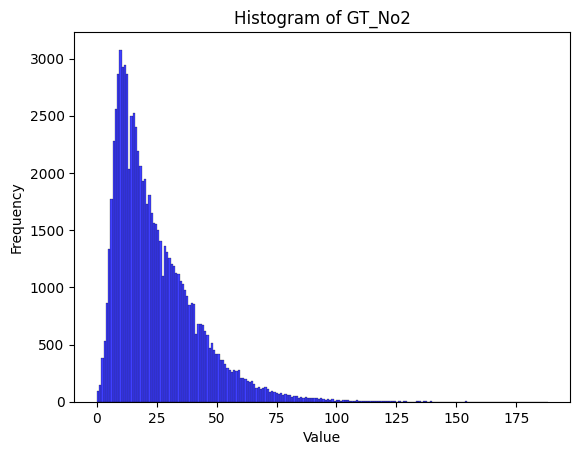

In [89]:
sns.histplot(train["GT_NO2"], bins=202, kde=False, color='blue', edgecolor='black')

# Customize labels and title
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of GT_No2')

# Display the plot
plt.show()

In [90]:
# sns.histplot(train["TropopausePressure"], bins=9, kde=False, color='blue', edgecolor='black')

# # Customize labels and title
# plt.xlabel('Value')
# plt.ylabel('Frequency')
# plt.title('Histogram of TropopausePressure')

# # Display the plot
# plt.show()

In [91]:
# # Create a figure and a set of subplots
# fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# # Plot the first histogram in the first subplot
# sns.histplot(train["CloudFraction"], bins=50, kde=False, color='blue', edgecolor='black', ax=axes[0, 0])
# axes[0, 0].set_xlabel('Value')
# axes[0, 0].set_ylabel('Frequency')
# axes[0, 0].set_title('Histogram of CloudFraction')

# # Plot the second histogram in the second subplot
# sns.histplot(data["CloudFraction"], bins=50, kde=False, color='blue', edgecolor='black', ax=axes[0, 1])
# axes[0, 1].set_xlabel('Value')
# axes[0, 1].set_ylabel('Frequency')
# axes[0, 1].set_title('Histogram of CloudFraction')

# # Plot the third histogram in the third subplot
# sns.histplot(data["NO2_strat"], bins=200, kde=False, color='blue', edgecolor='black', ax=axes[0, 2])
# axes[0, 2].set_xlabel('Value')
# axes[0, 2].set_ylabel('Frequency')
# axes[0, 2].set_title('Histogram of NO2_strat')

# # Plot the fourth histogram in the fourth subplot
# sns.histplot(train["NO2_total"], bins=50, kde=False, color='blue', edgecolor='black', ax=axes[1, 0])
# axes[1, 0].set_xlabel('Value')
# axes[1, 0].set_ylabel('Frequency')
# axes[1, 0].set_title('Histogram of NO2_total')

# # Plot the fifth histogram in the fifth subplot
# sns.histplot(train["NO2_trop"], bins=50, kde=False, color='blue', edgecolor='black', ax=axes[1, 1])
# axes[1, 1].set_xlabel('Value')
# axes[1, 1].set_ylabel('Frequency')
# axes[1, 1].set_title('Histogram of NO2_trop')

# # Plot the sixth histogram in the sixth subplot
# sns.histplot(train["LST"], bins=500, kde=False, color='blue', edgecolor='black', ax=axes[1, 2])
# axes[1, 2].set_xlabel('Value')
# axes[1, 2].set_ylabel('Frequency')
# axes[1, 2].set_title('Histogram of LST')

# # Adjust layout
# plt.tight_layout()

# # Display the plot
# plt.show()


In [92]:
train['Date'] = pd.to_datetime(train['Date'], format = 'mixed')
test['Date'] = pd.to_datetime(test['Date'], format = 'mixed')

In [93]:
# plt.figure(figsize=(12, 6))

# # Plot using Seaborn's lineplot
# sns.lineplot(x = train["Date"], y="GT_NO2", data=train)

# # Rotate x-axis labels for better readability (optional)
# plt.xticks(rotation=45)

# # Add labels and title
# plt.xlabel('Date')
# plt.ylabel('Value')
# plt.title('Time Series Plot')

# # Display the plot
# plt.tight_layout()
# plt.show()


In [94]:
# plt.figure(figsize=(12, 6))
# # Plot using Seaborn's lineplot
# sns.lineplot(x = train["Date"], y="LST", data=train)

# # Rotate x-axis labels for better readability (optional)
# plt.xticks(rotation=45)

# # Add labels and title
# plt.xlabel('Date')
# plt.ylabel('Value')
# plt.title('Time Series Plot')

# # Display the plot
# plt.tight_layout()
# plt.show()


In [95]:
# # Convert to a GeoDataFrame
# gdf = gpd.GeoDataFrame(train, geometry=gpd.points_from_xy(train.LON, train.LAT))

# # Plot the map with NO₂ concentrations
# fig, ax = plt.subplots(1, 1, figsize=(12, 8))
# gdf.plot(column='GT_NO2', cmap='Reds', markersize=10, legend=True, ax=ax)
# plt.title('GT NO₂ Concentration Across Locations')
# plt.show()


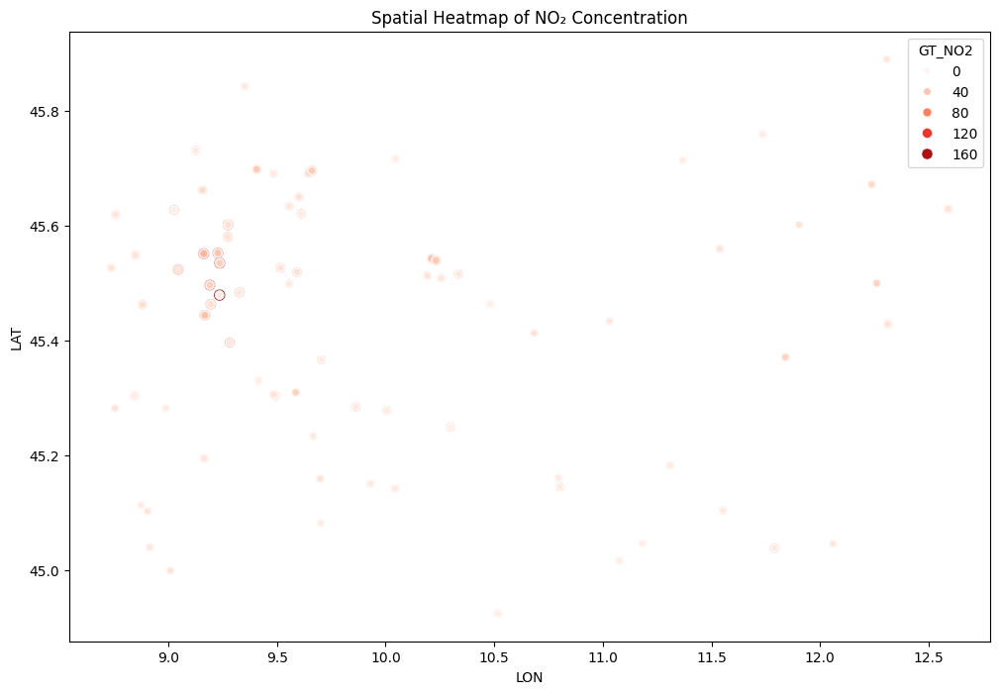

In [96]:
# Scatter plot with color indicating GT_NO2 levels
plt.figure(figsize=(12, 8))
sns.scatterplot(data=train, x='LON', y='LAT', hue='GT_NO2', palette='Reds', size='GT_NO2', legend=True)
plt.title('Spatial Heatmap of NO₂ Concentration')
plt.show()


In [97]:
train['ID'].value_counts()

ID
PD01      1096
X5591     1096
X5609     1096
X5607     1096
X5603     1096
          ... 
X10507    1096
X10458    1096
X10452    1096
X10331    1096
X9999     1096
Name: count, Length: 79, dtype: int64

In [98]:
test['ID'].value_counts()

ID
PD03     1096
TV03     1096
X5561    1096
X5953    1096
X6701    1096
X6877    1096
Name: count, dtype: int64

In [99]:
test.shape

(6576, 12)

In [100]:
train['GT_NO2'].isna().sum()

4533

In [101]:
train[train['GT_NO2'].isna()]['ID'].value_counts()

ID
X20495    798
X20491    790
X9877     190
X17286    160
X5545     128
         ... 
VE03        8
X5611       8
RO03        6
X5557       6
VI04        3
Name: count, Length: 79, dtype: int64

In [102]:
# train = train.sort_values(by=['ID', 'Date'])

In [103]:
train.head()

,ID_Zindi,Date,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
0,ID_ENTGC7,2019-01-01,PD01,45.601585,11.903551,0.000000,0.230527,0.559117,0.000024,0.000117,NaN,14440.82126,31.0
28835,ID_EWBJKR,2020-01-01,PD01,45.601585,11.903551,0.000000,-1.278574,0.001923,0.000029,0.000129,0.000101,14443.81910,26.0
57749,ID_DY1J5C,2021-01-01,PD01,45.601585,11.903551,6.616453,NaN,NaN,NaN,NaN,NaN,NaN,13.0
21567,ID_NJ8THA,2019-01-10,PD01,45.601585,11.903551,0.000000,-0.948916,0.380285,0.000043,0.000091,0.000034,13745.32280,14.0
50481,ID_P08I88,2020-01-10,PD01,45.601585,11.903551,0.000000,-1.215117,0.535160,0.000043,0.000135,NaN,16711.77588,17.0


<Axes: >

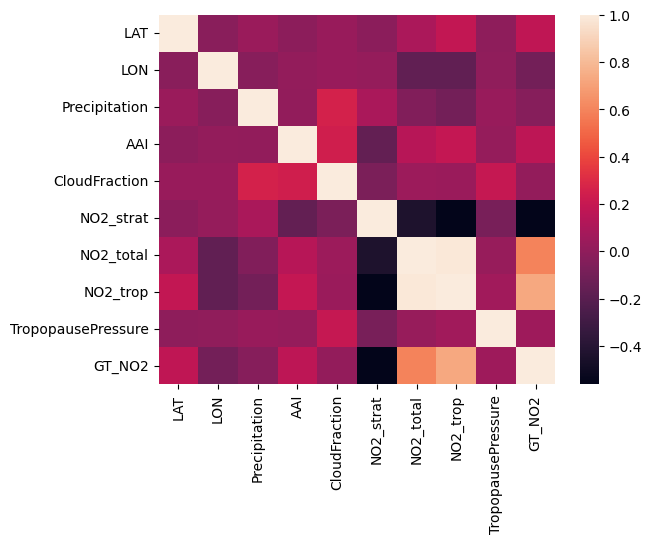

In [104]:
sns.heatmap(train.select_dtypes('number').corr())

In [105]:
# for col in train.select_dtypes('number').columns:
#     sns.displot(train[col], bins = 50)

In [106]:
import plotly.express as px
from sklearn.cluster import KMeans, DBSCAN

# Ensure the dataset is preprocessed correctly
# features = train[['LAT', 'LON']].dropna()

# Apply KMeans clustering
kmeans = KMeans(n_clusters=30, random_state=42)
train['kmeans_cluster30']  = kmeans.fit_predict(train[['LAT', 'LON']])
test['kmeans_cluster30'] = kmeans.predict(test[['LAT', 'LON']])


kmeans = KMeans(n_clusters=5, random_state=42)
train['kmeans_cluster5']  = kmeans.fit_predict(train[['LAT', 'LON']])
test['kmeans_cluster5'] = kmeans.predict(test[['LAT', 'LON']])


kmeans = KMeans(n_clusters=15, random_state=42)
train['kmeans_cluster15']  = kmeans.fit_predict(train[['LAT', 'LON']])
test['kmeans_cluster15'] = kmeans.predict(test[['LAT', 'LON']])

kmeans = KMeans(n_clusters=45, random_state=42)
train['kmeans_cluster45']  = kmeans.fit_predict(train[['LAT', 'LON']])
test['kmeans_cluster45'] = kmeans.predict(test[['LAT', 'LON']])


# # Plot KMeans clusters using Plotly
fig_kmeans = px.scatter(
    pd.concat([train,test],axis = 0), 
    x='LON', 
    y='LAT', 
    color='kmeans_cluster15', 
    hover_data=['GT_NO2','ID'],
    title='KMeans Clustering',
    color_continuous_scale='Viridis'
)
fig_kmeans.update_layout(xaxis_title='Longitude', yaxis_title='Latitude')

# # Plot KMeans clusters using Plotly
fig_kmeans1 = px.scatter(
    test,
    x='LON', 
    y='LAT', 
    color='ID', 
    hover_data=['ID'],
    title='KMeans Clustering',
    color_continuous_scale='Viridis'
)
fig_kmeans1.update_layout(xaxis_title='Longitude', yaxis_title='Latitude')


# Plot DBSCAN clusters using Plotly
fig_dbscan = px.scatter(
    pd.concat([train,test],axis = 0), 
    x='LON', 
    y='LAT', 
    hover_data=['GT_NO2','ID'],
    title='DBSCAN Clustering',
    color_continuous_scale='Plasma'
)
fig_dbscan.update_layout(xaxis_title='Longitude', yaxis_title='Latitude')

# Show both figures
fig_kmeans.show()
fig_kmeans1.show()
fig_dbscan.show()




In [107]:
def preprocessing_data(data):
    # data['Date'] = pd.to_datetime(data['Date'],format = 'mixed')

    data = data.sort_values(['ID','Date'],ascending = True)

    if 'GT_NO2' in data:
        temp_df = data.groupby('ID')['GT_NO2'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['GT_NO2']]
        data['GT_NO2'].fillna(temp_df['GT_NO2'],inplace = True)

    if 'Precipitation' in data:
        temp_df = data.groupby('ID')['Precipitation'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['Precipitation']]
        data['Precipitation'].fillna(temp_df['Precipitation'],inplace = True)

    if 'LST' in data:
        temp_df = data.groupby('ID')['LST'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['LST']]
        data['LST'].fillna(temp_df['LST'],inplace = True)


    data['NO2_trop'] = data['NO2_trop'].fillna(data['NO2_total'] - data['NO2_strat'])
    data['NO2_strat'] = data['NO2_strat'].fillna(data['NO2_total'] - data['NO2_trop'])
    data['NO2_total'] = data['NO2_total'].fillna(data['NO2_strat'] + data['NO2_trop'])

    
    if 'NO2_trop' in data:
        temp_df = data.groupby('ID')['NO2_trop'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['NO2_trop']]
        data['NO2_trop'].fillna(temp_df['NO2_trop'],inplace = True)

    if 'NO2_strat' in data:
        temp_df = data.groupby('ID')['NO2_strat'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['NO2_strat']]
        data['NO2_strat'].fillna(temp_df['NO2_strat'],inplace = True)

    if 'TropopausePressure' in data:
        temp_df = data.groupby('ID')['TropopausePressure'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['TropopausePressure']]
        data['TropopausePressure'].fillna(temp_df['TropopausePressure'],inplace = True)

    if 'CloudFraction' in data:
        temp_df = data.groupby('ID')['CloudFraction'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['CloudFraction']]
        data['CloudFraction'].fillna(temp_df['CloudFraction'],inplace = True)

    if 'AAI' in data:
        temp_df = data.groupby('ID')['AAI'].apply(lambda x: x.rolling(window=7, min_periods=1).mean()).reset_index()[['AAI']]
        data['AAI'].fillna(temp_df['AAI'],inplace = True)


    data['NO2_total'] = data['NO2_total'].fillna(data['NO2_strat'] + data['NO2_trop'])


    data[['NO2_strat', 'AAI', 'NO2_trop', 'CloudFraction', 'TropopausePressure']] = data[['NO2_strat', 'AAI', 'NO2_trop', 'CloudFraction', 'TropopausePressure']].bfill()

    

    return data
    
    


In [108]:
train = preprocessing_data(train)
test = preprocessing_data(test)

# train = train.dropna()

C:\Users\DELL\AppData\Local\Temp\ipykernel_28800\1241562744.py:8: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



C:\Users\DELL\AppData\Local\Temp\ipykernel_28800\1241562744.py:12: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=T

In [109]:
train.isna().sum()

ID_Zindi               0
Date                   0
ID                     0
LAT                    0
LON                    0
Precipitation          0
AAI                    0
CloudFraction          0
NO2_strat              0
NO2_total             47
NO2_trop               0
TropopausePressure     0
GT_NO2                88
kmeans_cluster30       0
kmeans_cluster5        0
kmeans_cluster15       0
kmeans_cluster45       0
dtype: int64

In [110]:
test.isna().sum()

ID_Zindi              0
Date                  0
ID                    0
LAT                   0
LON                   0
Precipitation         0
AAI                   0
CloudFraction         0
NO2_strat             0
NO2_total             6
NO2_trop              0
TropopausePressure    0
kmeans_cluster30      0
kmeans_cluster5       0
kmeans_cluster15      0
kmeans_cluster45      0
dtype: int64

In [111]:
train = train.dropna(subset = ['GT_NO2'])

In [112]:
train.shape

(86496, 17)

In [113]:
import pandas as pd
import numpy as np
from scipy import stats

def remove_global_outliers(df, column='GT_NO2', z_threshold=3.5):
    """
    Remove outliers from a single column using z-score method
    
    Parameters:
    df : DataFrame
        Input DataFrame
    column : str
        Column name to remove outliers from
    z_threshold : float
        Z-score threshold (default=3)
        
    Returns:
    DataFrame with outliers removed and statistics
    """
    # Calculate z-scores
    z_scores = np.abs(stats.zscore(df[column]))
    
    # Create mask for non-outlier data
    non_outliers_mask = z_scores < z_threshold
    
    # Get clean dataframe
    df_clean = df[non_outliers_mask].copy()
    
    # Calculate statistics
    stats_result = {
        'total_rows': len(df),
        'rows_removed': len(df) - len(df_clean),
        'percentage_removed': ((len(df) - len(df_clean)) / len(df) * 100),
        'mean_before': df[column].mean(),
        'mean_after': df_clean[column].mean(),
        'std_before': df[column].std(),
        'std_after': df_clean[column].std()
    }
    
    return df_clean, stats_result

# Example usage:
# df_clean, stats = remove_global_outliers(df)
# 
# Print statistics
print_stats = """
Outlier Removal Statistics:
--------------------------
Total rows: {total_rows}
Rows removed: {rows_removed} ({percentage_removed:.2f}%)
Mean before: {mean_before:.2f}
Mean after: {mean_after:.2f}
Std before: {std_before:.2f}
Std after: {std_after:.2f}
"""

In [114]:
from scipy import stats

In [115]:
# Apply the function
train, stats_result = remove_global_outliers(train)

# Print the statistics
print(print_stats.format(**stats_result))


Outlier Removal Statistics:
--------------------------
Total rows: 86496
Rows removed: 706 (0.82%)
Mean before: 24.52
Mean after: 23.92
Std before: 16.93
Std after: 15.57



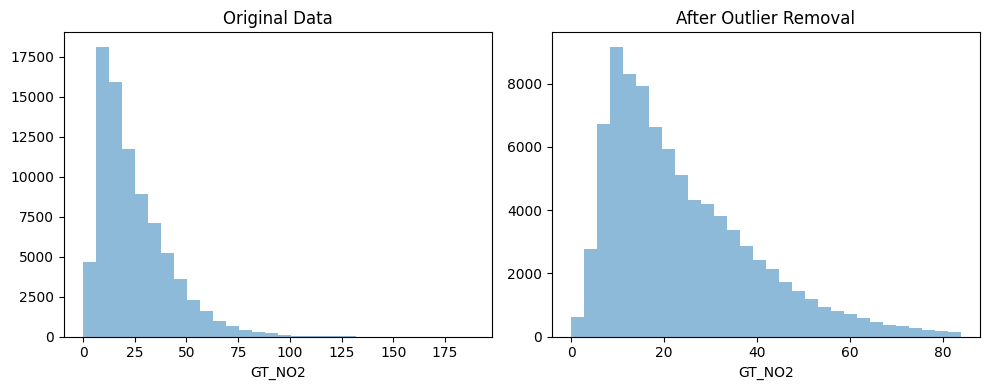

In [116]:


# If you want to see the effect visually
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 4))
plt.subplot(121)
plt.hist(original_train['GT_NO2'], bins=30, alpha=0.5, label='Original')
plt.title('Original Data')
plt.xlabel('GT_NO2')

plt.subplot(122)
plt.hist(train['GT_NO2'], bins=30, alpha=0.5, label='After Outlier Removal')
plt.title('After Outlier Removal')
plt.xlabel('GT_NO2')

plt.tight_layout()
plt.show()

In [117]:
train.groupby('kmeans_cluster15')['GT_NO2'].agg(['mean','median','min','max'])

,mean,median,min,max
kmeans_cluster15,,,,
0,24.813106,20.467857,0.000,83.600000
1,32.174403,28.525000,0.000,83.675000
2,28.278114,25.000000,5.000,76.000000
3,20.036597,16.575000,1.050,82.600000
4,25.500225,21.850000,0.000,83.725000
5,19.478827,15.425000,0.175,81.150000
6,24.329116,21.000000,2.000,79.000000
7,19.103084,16.175000,0.025,72.775000
8,22.829845,18.500000,0.200,82.800000


In [118]:
train.isna().sum()

ID_Zindi               0
Date                   0
ID                     0
LAT                    0
LON                    0
Precipitation          0
AAI                    0
CloudFraction          0
NO2_strat              0
NO2_total             46
NO2_trop               0
TropopausePressure     0
GT_NO2                 0
kmeans_cluster30       0
kmeans_cluster5        0
kmeans_cluster15       0
kmeans_cluster45       0
dtype: int64

In [119]:
num_cols = train.select_dtypes(include='number').drop(['GT_NO2','LAT','LON','kmeans_cluster5','kmeans_cluster45','kmeans_cluster15','kmeans_cluster30'],axis=1).columns.to_list()

In [120]:
num_cols

['Precipitation',
 'AAI',
 'CloudFraction',
 'NO2_strat',
 'NO2_total',
 'NO2_trop',
 'TropopausePressure']

In [121]:
import pandas as pd
import numpy as np
import math

def calc_daylight_hours(lat, day_of_year):
    """Calculate approximate daylight hours using latitude and day of year"""
    declination = 23.44 * math.cos(math.radians((360/365) * (day_of_year - 81)))
    daylight = 24 - (24/math.pi) * math.acos(math.tan(math.radians(lat)) * math.tan(math.radians(declination)))
    return max(0, min(24, daylight))

def calc_sunlight(lat, day_of_year):
    """Estimate hours of sunlight using latitude and day of year"""
    declination = 23.45 * np.sin(np.radians(360/365 * (day_of_year - 81)))
    sunlight = 12 + (24/np.pi) * np.arccos(-np.tan(np.radians(lat)) * np.tan(np.radians(declination)))
    return sunlight

def get_season(date_series):
    """Convert dates to seasons (0=Spring, 1=Summer, 2=Autumn, 3=Winter)"""
    def _is_between_dates(month, day, start_m, start_d, end_m, end_d):
        if start_m <= end_m:
            return ((month > start_m) & (month < end_m)) | \
                   ((month == start_m) & (day >= start_d)) | \
                   ((month == end_m) & (day <= end_d))
        return ((month >= start_m) & (day >= start_d)) | \
               (month < end_m) | \
               ((month == end_m) & (day <= end_d))

    seasons = pd.Series(3, index=date_series.index)  # Default to winter (3)
    m, d = date_series.dt.month, date_series.dt.day
    
    seasons.loc[_is_between_dates(m, d, 3, 1, 6, 15)] = 0  # Spring
    seasons.loc[_is_between_dates(m, d, 6, 16, 9, 15)] = 1  # Summer
    seasons.loc[_is_between_dates(m, d, 9, 16, 12, 15)] = 2  # Autumn
    
    return seasons

def process_gtno2_data(df, window=3):
    """Process GT_NO2 data with various aggregations and rolling means"""
    # Sort dataframe
    df = df.sort_values(['ID', 'Date'])
    
    # Create shifts for numeric columns
    for shift in [1, 2]:
        df[[f'{col}_shift{shift}' for col in num_cols]] = df[num_cols].shift(shift)
    
    # Calculate rolling means
    rolled = df.groupby('ID')[num_cols].rolling(window=window, min_periods=1).mean()
    rolled = rolled.reset_index(level=0, drop=True).add_suffix(f'_rolling_mean_{window}')
    
    # Add shifts for rolling means
    for shift in [1, 2]:
        rolled[[f'{col}_{window}_shift{shift}' for col in rolled.columns]] = rolled.shift(shift)
    
    # Combine base dataframe with rolling means
    result = pd.concat([df.reset_index(drop=True), rolled.reset_index(drop=True)], axis=1)
    
    # Add daily statistics
    daily_stats = {
        'daily_average_gtno2': df.groupby('Date')['GT_NO2'].mean(),
        'daily_median_gtno2': df.groupby('Date')['GT_NO2'].median()
    }
    
    # Process cluster-based statistics
    clusters = [15, 30, 45]
    for cluster in clusters:
        prefix = f'kmeans_cluster{cluster}'
        
        # Rolling averages
        result[f'{prefix}_rolling_average_gtno2'] = df.groupby([prefix, 'Date'])['GT_NO2'].rolling(
            window=window, min_periods=1).mean().reset_index(drop=True)
        
        # Shifted averages
        for shift in [1, 2]:
            result[f'{prefix}_shift{shift}_average_gtno2'] = df.groupby([prefix, 'Date'])['GT_NO2'].mean().shift(shift).reset_index(drop=True)
    
    # Add daily statistics to result
    for col, series in daily_stats.items():
        result[col] = result['Date'].map(series)
    
    return result

In [122]:
def adding_features(data):

    from sklearn.preprocessing import LabelEncoder

    le = LabelEncoder()


    # Label encode categorical feature
    data['ID'] = le.fit_transform(data['ID'])

    #time features
    # Fixed-Width Binning: Create bins of equal width for each column
    def fixed_width_binning(column, bins=15):
        return pd.cut(column, bins=bins, labels=False)

    # Quantile Binning: Create bins based on quantiles (equal-sized groups)
    def quantile_binning(column, bins=15):
        return pd.qcut(column, q=bins, labels=False, duplicates='drop')

    def apply_binning(data, method='fixed', bins=10):
        binned_data = data.copy()
        # numeric_cols = data.select_dtypes('number').columns
        # if 'GT_NO2' in numeric_cols:
        #     numeric_cols = numeric_cols.drop('GT_NO2')
        for col in num_cols:
            if method == 'fixed':
                binned_data[f'{col}_{bins}_bin'] = fixed_width_binning(data[col], bins)
            elif method == 'quantile':
                binned_data[f'{col}_{bins}_bin'] = quantile_binning(data[col], bins)
        return binned_data
    

    data = data.sort_values(['ID','Date'])
    data = apply_binning(data, method='fixed', bins=30)
    data = apply_binning(data, method='fixed', bins=60)

    for col in num_cols:
        data[f'{col}_shift1'] = data[col].shift(1)
        data[f'{col}_shift2'] = data[col].shift(2)

    data['year'] = data['Date'].dt.year
    data['day'] = data['Date'].dt.day
    data['Month'] = data['Date'].dt.month
    data['week'] = data['Date'].dt.isocalendar().week
    data['quarter'] = data['Date'].dt.quarter
   
    data['weekday'] = data['Date'].dt.weekday
    data['day_of_week'] = data['Date'].dt.dayofweek
    data['is_weekend'] = data['day_of_week'].apply(lambda x: 1 if x >= 5 else 0)
    data['season'] = data['Month'] % 12 // 3 + 1  # Seasons: Winter, Spring, Summer, Fall
    data['Season_plus'] = get_season(data['Date']).astype('category')

    # data['is_day'] = data['hour'].between(6, 18).astype(int)  # 1 if day, 0 if night
    data['Month_sin'] = np.sin(2 * np.pi * data['Month'] / 12)
    data['Month_cos'] = np.cos(2 * np.pi * data['Month'] / 12)

    data['is_rain'] = np.where(data['Precipitation'] > 0,1,0)
    data['NO2_composite'] = 0.3 * data['NO2_strat'] + 0.7 * data['NO2_trop']


    data['day_of_year'] = data['Date'].dt.dayofyear
    data['daylight_hours'] = data.apply(lambda row: calc_daylight_hours(row['LAT'], row['day_of_year']), axis=1)

    data['sunlight_hours'] = data.apply(lambda row: calc_sunlight(row['LAT'], row['day_of_year']), axis=1)

 

    for col in data.select_dtypes('object'):
        data[col] = data[col].fillna(data[col].mode()[0])
    for col in data.select_dtypes('number'):
        data[col] = data[col].fillna(data[col].mean())


    return data






In [123]:
train.groupby('ID')['GT_NO2'].mean().sort_values(ascending = False).head(5).index.to_list()
odd_locs = ['X6781', 'X5504', 'X5532', 'X5587', 'X9877']

train = train[~(train['ID'].isin(odd_locs))]

In [124]:
train['train/test'] = 1
test['train/test'] = 0

all_data = pd.concat([train,test],axis=0)
all_data = adding_features(all_data)

test = all_data[all_data['train/test'] == 0]
train = all_data[all_data['train/test'] == 1]
# train = adding_features(train)
# test = adding_features(test)

In [125]:
train.shape, test.shape

((80578, 63), (6576, 63))

In [126]:
train.head()

,ID_Zindi,Date,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2,kmeans_cluster30,kmeans_cluster5,kmeans_cluster15,kmeans_cluster45,train/test,Precipitation_30_bin,AAI_30_bin,CloudFraction_30_bin,NO2_strat_30_bin,NO2_total_30_bin,NO2_trop_30_bin,TropopausePressure_30_bin,...,NO2_strat_shift1,NO2_strat_shift2,NO2_total_shift1,NO2_total_shift2,NO2_trop_shift1,NO2_trop_shift2,TropopausePressure_shift1,TropopausePressure_shift2,year,day,Month,week,quarter,weekday,day_of_week,is_weekend,season,Season_plus,Month_sin,Month_cos,is_rain,NO2_composite,day_of_year,daylight_hours,sunlight_hours
0,ID_ENTGC7,2019-01-01,0,45.601585,11.903551,0.000000,0.230527,0.559117,0.000024,0.000117,0.000093,14440.821260,31.0,29,2,11,29,1,0,21,16,5,1.0,2,11,...,0.000045,0.000045,0.000153,0.000153,0.000107,0.000107,16664.447659,16664.488988,2019,1,1,1,1,1,1,0,1,3,0.5,0.866025,0,0.000072,1,12.616181,20.572747
2449,ID_FU6RYN,2019-01-02,0,45.601585,11.903551,19.754627,-1.360930,0.128312,0.000044,0.000101,0.000057,14709.426373,27.0,29,2,11,29,1,4,14,3,15,1.0,1,11,...,0.000024,0.000045,0.000117,0.000153,0.000093,0.000107,14440.821260,16664.488988,2019,2,1,1,1,2,2,0,1,3,0.5,0.866025,1,0.000053,2,12.670560,20.587197
4661,ID_AXEIQP,2019-01-03,0,45.601585,11.903551,0.000000,-0.366405,0.814226,0.000036,0.000110,0.000074,19300.950800,36.0,29,2,11,29,1,0,18,24,11,1.0,1,20,...,0.000044,0.000024,0.000101,0.000117,0.000057,0.000093,14709.426373,14440.821260,2019,3,1,1,1,3,3,0,1,3,0.5,0.866025,0,0.000063,3,12.724837,20.602823
7110,ID_P8G3Q4,2019-01-04,0,45.601585,11.903551,0.000000,-0.983072,0.050221,0.000050,0.000106,0.000056,19306.016130,25.0,29,2,11,29,1,0,16,1,18,1.0,1,20,...,0.000036,0.000044,0.000110,0.000101,0.000074,0.000057,19300.950800,14709.426373,2019,4,1,1,1,4,4,0,1,3,0.5,0.866025,0,0.000054,4,12.779004,20.619614
9480,ID_85S7EJ,2019-01-05,0,45.601585,11.903551,0.000000,-1.199141,0.015730,0.000063,0.000129,0.000066,19301.828870,13.0,29,2,11,29,1,0,15,0,25,2.0,1,20,...,0.000050,0.000036,0.000106,0.000110,0.000056,0.000074,19306.016130,19300.950800,2019,5,1,1,1,5,5,1,1,3,0.5,0.866025,0,0.000065,5,12.833050,20.637554


In [127]:
train.head(10)

,ID_Zindi,Date,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2,kmeans_cluster30,kmeans_cluster5,kmeans_cluster15,kmeans_cluster45,train/test,Precipitation_30_bin,AAI_30_bin,CloudFraction_30_bin,NO2_strat_30_bin,NO2_total_30_bin,NO2_trop_30_bin,TropopausePressure_30_bin,...,NO2_strat_shift1,NO2_strat_shift2,NO2_total_shift1,NO2_total_shift2,NO2_trop_shift1,NO2_trop_shift2,TropopausePressure_shift1,TropopausePressure_shift2,year,day,Month,week,quarter,weekday,day_of_week,is_weekend,season,Season_plus,Month_sin,Month_cos,is_rain,NO2_composite,day_of_year,daylight_hours,sunlight_hours
0,ID_ENTGC7,2019-01-01,0,45.601585,11.903551,0.000000,0.230527,0.559117,0.000024,0.000117,0.000093,14440.821260,31.0,29,2,11,29,1,0,21,16,5,1.0,2,11,...,0.000045,0.000045,0.000153,0.000153,0.000107,0.000107,16664.447659,16664.488988,2019,1,1,1,1,1,1,0,1,3,0.5,0.866025,0,0.000072,1,12.616181,20.572747
2449,ID_FU6RYN,2019-01-02,0,45.601585,11.903551,19.754627,-1.360930,0.128312,0.000044,0.000101,0.000057,14709.426373,27.0,29,2,11,29,1,4,14,3,15,1.0,1,11,...,0.000024,0.000045,0.000117,0.000153,0.000093,0.000107,14440.821260,16664.488988,2019,2,1,1,1,2,2,0,1,3,0.5,0.866025,1,0.000053,2,12.670560,20.587197
4661,ID_AXEIQP,2019-01-03,0,45.601585,11.903551,0.000000,-0.366405,0.814226,0.000036,0.000110,0.000074,19300.950800,36.0,29,2,11,29,1,0,18,24,11,1.0,1,20,...,0.000044,0.000024,0.000101,0.000117,0.000057,0.000093,14709.426373,14440.821260,2019,3,1,1,1,3,3,0,1,3,0.5,0.866025,0,0.000063,3,12.724837,20.602823
7110,ID_P8G3Q4,2019-01-04,0,45.601585,11.903551,0.000000,-0.983072,0.050221,0.000050,0.000106,0.000056,19306.016130,25.0,29,2,11,29,1,0,16,1,18,1.0,1,20,...,0.000036,0.000044,0.000110,0.000101,0.000074,0.000057,19300.950800,14709.426373,2019,4,1,1,1,4,4,0,1,3,0.5,0.866025,0,0.000054,4,12.779004,20.619614
9480,ID_85S7EJ,2019-01-05,0,45.601585,11.903551,0.000000,-1.199141,0.015730,0.000063,0.000129,0.000066,19301.828870,13.0,29,2,11,29,1,0,15,0,25,2.0,1,20,...,0.000050,0.000036,0.000106,0.000110,0.000056,0.000074,19306.016130,19300.950800,2019,5,1,1,1,5,5,1,1,3,0.5,0.866025,0,0.000065,5,12.833050,20.637554
11929,ID_TPAVHN,2019-01-06,0,45.601585,11.903551,0.000000,-0.997789,0.024476,0.000060,0.000094,0.000034,16727.642410,14.0,29,2,11,29,1,0,16,0,23,1.0,1,15,...,0.000063,0.000050,0.000129,0.000106,0.000066,0.000056,19301.828870,19306.016130,2019,6,1,1,1,6,6,1,1,3,0.5,0.866025,0,0.000042,6,12.886966,20.656632
14299,ID_DAGKO5,2019-01-07,0,45.601585,11.903551,0.000000,-1.286661,0.053396,0.000060,0.000131,0.000071,9583.151365,21.0,29,2,11,29,1,0,15,1,23,2.0,1,1,...,0.000060,0.000063,0.000094,0.000129,0.000034,0.000066,16727.642410,19301.828870,2019,7,1,2,1,0,0,0,1,3,0.5,0.866025,0,0.000068,7,12.940743,20.676830
16748,ID_58KMT1,2019-01-08,0,45.601585,11.903551,0.000000,-2.524457,0.083831,0.000058,0.000099,0.000041,14433.187880,18.0,29,2,11,29,1,0,10,2,22,1.0,1,11,...,0.000060,0.000060,0.000131,0.000094,0.000071,0.000034,9583.151365,16727.642410,2019,8,1,2,1,1,1,0,1,3,0.5,0.866025,0,0.000046,8,12.994371,20.698135
19197,ID_0P525G,2019-01-09,0,45.601585,11.903551,0.000000,-1.923721,0.046884,0.000056,0.000095,0.000039,14431.402850,11.0,29,2,11,29,1,0,12,1,21,1.0,1,11,...,0.000058,0.000060,0.000099,0.000131,0.000041,0.000071,14433.187880,9583.151365,2019,9,1,2,1,2,2,0,1,3,0.5,0.866025,0,0.000044,9,13.047840,20.720530
21567,ID_NJ8THA,2019-01-10,0,45.601585,11.903551,0.000000,-0.948916,0.380285,0.000043,0.000091,0.000034,13745.322800,14.0,29,2,11,29,1,0,16,11,14,1.0,1,9,...,0.000056,0.000058,0.000095,0.000099,0.000039,0.000041,14431.402850,14433.187880,2019,10,1,2,1,3,3,0,1,3,0.5,0.866025,0,0.000037,10,13.101139,20.743997


In [128]:
train.isna().sum().sort_values()

ID_Zindi                     0
Precipitation_shift2         0
AAI_shift1                   0
AAI_shift2                   0
CloudFraction_shift1         0
CloudFraction_shift2         0
NO2_strat_shift1             0
NO2_strat_shift2             0
NO2_total_shift1             0
NO2_total_shift2             0
NO2_trop_shift1              0
NO2_trop_shift2              0
TropopausePressure_shift1    0
TropopausePressure_shift2    0
Precipitation_shift1         0
year                         0
Month                        0
week                         0
quarter                      0
weekday                      0
day_of_week                  0
is_weekend                   0
season                       0
Season_plus                  0
Month_sin                    0
Month_cos                    0
is_rain                      0
NO2_composite                0
day_of_year                  0
day                          0
daylight_hours               0
TropopausePressure_60_bin    0
NO2_tota

In [129]:
from sklearn.preprocessing import StandardScaler,RobustScaler,MinMaxScaler
data = train.select_dtypes('number')

# Drop any rows with missing values (or handle them differently if needed)
data = data.dropna()

# Separate features (X) and target variable (y)
X = data.drop(['GT_NO2','train/test'], axis=1) 
# 'ID','LAT','LON','year','Month'
y = data['GT_NO2'] # Predicting GT_NO2

features = X.columns.to_list()

test_features = test[features]

test_features.head(8)


,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,kmeans_cluster30,kmeans_cluster5,kmeans_cluster15,kmeans_cluster45,Precipitation_30_bin,AAI_30_bin,CloudFraction_30_bin,NO2_strat_30_bin,NO2_total_30_bin,NO2_trop_30_bin,TropopausePressure_30_bin,Precipitation_60_bin,AAI_60_bin,CloudFraction_60_bin,NO2_strat_60_bin,...,CloudFraction_shift2,NO2_strat_shift1,NO2_strat_shift2,NO2_total_shift1,NO2_total_shift2,NO2_trop_shift1,NO2_trop_shift2,TropopausePressure_shift1,TropopausePressure_shift2,year,day,Month,week,quarter,weekday,day_of_week,is_weekend,season,Month_sin,Month_cos,is_rain,NO2_composite,day_of_year,daylight_hours,sunlight_hours
0,1,45.289376,11.642394,3.277529,-0.313361,0.771456,0.000024,0.000075,0.000051,14440.02819,12,4,2,12,0,19,23,5,1.0,1,11,1,38,46,10,...,0.130656,0.000032,0.000033,0.000152,0.000155,0.000120,0.000122,13063.80704,13062.67716,2019,1,1,1,1,1,1,0,1,0.5,0.866025,1,0.000043,1,12.609487,20.612561
6,1,45.289376,11.642394,0.000000,-0.177263,0.166926,0.000033,0.000128,0.000057,20775.67062,12,4,2,12,0,19,5,9,2.0,1,23,0,39,10,19,...,0.007416,0.000024,0.000032,0.000075,0.000152,0.000051,0.000120,14440.02819,13063.80704,2019,2,1,1,1,2,2,0,1,0.5,0.866025,0,0.000050,2,12.663273,20.626819
12,1,45.289376,11.642394,0.000000,-0.716974,0.000000,0.000029,0.000065,0.000036,22243.31935,12,4,2,12,0,17,0,7,1.0,1,25,0,35,0,15,...,0.771456,0.000033,0.000024,0.000128,0.000075,0.000057,0.000051,20775.67062,14440.02819,2019,3,1,1,1,3,3,0,1,0.5,0.866025,0,0.000034,3,12.716957,20.642238
18,1,45.289376,11.642394,3.277529,-1.160514,0.000000,0.000021,0.000098,0.000077,19341.34954,12,4,2,12,0,15,0,3,1.0,1,20,1,31,0,7,...,0.166926,0.000029,0.000033,0.000065,0.000128,0.000036,0.000057,22243.31935,20775.67062,2019,4,1,1,1,4,4,0,1,0.5,0.866025,1,0.000060,4,12.770530,20.658806
24,1,45.289376,11.642394,0.000000,-0.887354,0.543159,0.000017,0.000148,0.000131,16727.79210,12,4,2,12,0,16,16,1,2.0,2,15,0,33,32,3,...,0.000000,0.000021,0.000029,0.000098,0.000065,0.000077,0.000036,19341.34954,22243.31935,2019,5,1,1,1,5,5,1,1,0.5,0.866025,0,0.000097,5,12.823984,20.676510
30,1,45.289376,11.642394,0.000000,-0.607999,0.055697,0.000022,0.000205,0.000182,16721.28774,12,4,2,12,0,17,1,4,3.0,3,15,0,35,3,8,...,0.000000,0.000017,0.000021,0.000148,0.000098,0.000131,0.000077,16727.79210,19341.34954,2019,6,1,1,1,6,6,1,1,0.5,0.866025,0,0.000134,6,12.877309,20.695335
36,1,45.289376,11.642394,0.000000,-0.214847,0.393373,0.000025,0.000047,0.000022,16729.36433,12,4,2,12,0,19,11,5,0.0,0,15,0,38,23,11,...,0.543159,0.000022,0.000017,0.000205,0.000148,0.000182,0.000131,16721.28774,16727.79210,2019,7,1,2,1,0,0,0,1,0.5,0.866025,0,0.000023,7,12.930494,20.715268
42,1,45.289376,11.642394,6.084889,-1.205161,0.294384,0.000026,0.000209,0.000183,16720.15603,12,4,2,12,1,15,8,6,3.0,3,15,2,31,17,13,...,0.055697,0.000025,0.000022,0.000047,0.000205,0.000022,0.000182,16729.36433,16721.28774,2019,8,1,2,1,1,1,0,1,0.5,0.866025,1,0.000136,8,12.983532,20.736294


In [130]:
1+1

2

In [131]:
train.columns.to_list()

['ID_Zindi',
 'Date',
 'ID',
 'LAT',
 'LON',
 'Precipitation',
 'AAI',
 'CloudFraction',
 'NO2_strat',
 'NO2_total',
 'NO2_trop',
 'TropopausePressure',
 'GT_NO2',
 'kmeans_cluster30',
 'kmeans_cluster5',
 'kmeans_cluster15',
 'kmeans_cluster45',
 'train/test',
 'Precipitation_30_bin',
 'AAI_30_bin',
 'CloudFraction_30_bin',
 'NO2_strat_30_bin',
 'NO2_total_30_bin',
 'NO2_trop_30_bin',
 'TropopausePressure_30_bin',
 'Precipitation_60_bin',
 'AAI_60_bin',
 'CloudFraction_60_bin',
 'NO2_strat_60_bin',
 'NO2_total_60_bin',
 'NO2_trop_60_bin',
 'TropopausePressure_60_bin',
 'Precipitation_shift1',
 'Precipitation_shift2',
 'AAI_shift1',
 'AAI_shift2',
 'CloudFraction_shift1',
 'CloudFraction_shift2',
 'NO2_strat_shift1',
 'NO2_strat_shift2',
 'NO2_total_shift1',
 'NO2_total_shift2',
 'NO2_trop_shift1',
 'NO2_trop_shift2',
 'TropopausePressure_shift1',
 'TropopausePressure_shift2',
 'year',
 'day',
 'Month',
 'week',
 'quarter',
 'weekday',
 'day_of_week',
 'is_weekend',
 'season',
 'Season

In [132]:
test_features

,ID,LAT,LON,Precipitation,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,kmeans_cluster30,kmeans_cluster5,kmeans_cluster15,kmeans_cluster45,Precipitation_30_bin,AAI_30_bin,CloudFraction_30_bin,NO2_strat_30_bin,NO2_total_30_bin,NO2_trop_30_bin,TropopausePressure_30_bin,Precipitation_60_bin,AAI_60_bin,CloudFraction_60_bin,NO2_strat_60_bin,...,CloudFraction_shift2,NO2_strat_shift1,NO2_strat_shift2,NO2_total_shift1,NO2_total_shift2,NO2_trop_shift1,NO2_trop_shift2,TropopausePressure_shift1,TropopausePressure_shift2,year,day,Month,week,quarter,weekday,day_of_week,is_weekend,season,Month_sin,Month_cos,is_rain,NO2_composite,day_of_year,daylight_hours,sunlight_hours
0,1,45.289376,11.642394,3.277529,-0.313361,0.771456,0.000024,0.000075,0.000051,14440.028190,12,4,2,12,0,19,23,5,1.0,1,11,1,38,46,10,...,0.130656,0.000032,0.000033,0.000152,0.000155,0.000120,0.000122,13063.807040,13062.677160,2019,1,1,1,1,1,1,0,1,5.000000e-01,0.866025,1,0.000043,1,12.609487,20.612561
6,1,45.289376,11.642394,0.000000,-0.177263,0.166926,0.000033,0.000128,0.000057,20775.670620,12,4,2,12,0,19,5,9,2.0,1,23,0,39,10,19,...,0.007416,0.000024,0.000032,0.000075,0.000152,0.000051,0.000120,14440.028190,13063.807040,2019,2,1,1,1,2,2,0,1,5.000000e-01,0.866025,0,0.000050,2,12.663273,20.626819
12,1,45.289376,11.642394,0.000000,-0.716974,0.000000,0.000029,0.000065,0.000036,22243.319350,12,4,2,12,0,17,0,7,1.0,1,25,0,35,0,15,...,0.771456,0.000033,0.000024,0.000128,0.000075,0.000057,0.000051,20775.670620,14440.028190,2019,3,1,1,1,3,3,0,1,5.000000e-01,0.866025,0,0.000034,3,12.716957,20.642238
18,1,45.289376,11.642394,3.277529,-1.160514,0.000000,0.000021,0.000098,0.000077,19341.349540,12,4,2,12,0,15,0,3,1.0,1,20,1,31,0,7,...,0.166926,0.000029,0.000033,0.000065,0.000128,0.000036,0.000057,22243.319350,20775.670620,2019,4,1,1,1,4,4,0,1,5.000000e-01,0.866025,1,0.000060,4,12.770530,20.658806
24,1,45.289376,11.642394,0.000000,-0.887354,0.543159,0.000017,0.000148,0.000131,16727.792100,12,4,2,12,0,16,16,1,2.0,2,15,0,33,32,3,...,0.000000,0.000021,0.000029,0.000098,0.000065,0.000077,0.000036,19341.349540,22243.319350,2019,5,1,1,1,5,5,1,1,5.000000e-01,0.866025,0,0.000097,5,12.823984,20.676510
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6551,70,45.151743,10.781408,9.026887,0.107122,0.015865,0.000028,0.000225,0.000198,19847.507620,3,0,3,3,2,20,0,7,3.0,3,21,4,41,0,14,...,0.378897,0.000034,0.000030,0.000162,0.000236,0.000128,0.000206,20803.086558,16803.899507,2021,27,12,52,4,0,0,0,1,-2.449294e-16,1.000000,1,0.000147,361,12.337712,20.576758
6557,70,45.151743,10.781408,0.000000,0.334839,0.137555,0.000028,0.000231,0.000203,18693.573958,3,0,3,3,0,21,4,7,3.0,3,19,0,43,8,14,...,0.134307,0.000028,0.000034,0.000225,0.000162,0.000198,0.000128,19847.507620,20803.086558,2021,28,12,52,4,1,1,0,1,-2.449294e-16,1.000000,0,0.000151,362,12.391615,20.585006
6563,70,45.151743,10.781408,0.000000,0.132894,0.281926,0.000024,0.000504,0.000481,15133.065733,3,0,3,3,0,20,8,5,7.0,7,12,0,41,16,10,...,0.015865,0.000028,0.000028,0.000231,0.000225,0.000203,0.000198,18693.573958,19847.507620,2021,29,12,52,4,2,2,0,1,-2.449294e-16,1.000000,0,0.000343,363,12.445460,20.594457
6569,70,45.151743,10.781408,0.000000,-0.787419,0.384483,0.000025,0.000257,0.000232,15204.268643,3,0,3,3,0,17,11,5,3.0,4,12,0,34,23,11,...,0.137555,0.000024,0.000028,0.000504,0.000231,0.000481,0.000203,15133.065733,18693.573958,2021,30,12,52,4,3,3,0,1,-2.449294e-16,1.000000,0,0.000170,364,12.499238,20.605102


In [133]:
test_features.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6576 entries, 0 to 6575
Data columns (total 58 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   ID                         6576 non-null   int32  
 1   LAT                        6576 non-null   float64
 2   LON                        6576 non-null   float64
 3   Precipitation              6576 non-null   float64
 4   AAI                        6576 non-null   float64
 5   CloudFraction              6576 non-null   float64
 6   NO2_strat                  6576 non-null   float64
 7   NO2_total                  6576 non-null   float64
 8   NO2_trop                   6576 non-null   float64
 9   TropopausePressure         6576 non-null   float64
 10  kmeans_cluster30           6576 non-null   int32  
 11  kmeans_cluster5            6576 non-null   int32  
 12  kmeans_cluster15           6576 non-null   int32  
 13  kmeans_cluster45           6576 non-null   int32  
 1

In [134]:
# import numpy as np
# import pandas as pd
# from sklearn.feature_selection import (
#     SelectKBest, 
#     f_regression, 
#     RFE
# )
# from sklearn.linear_model import LinearRegression
# from sklearn.ensemble import RandomForestRegressor

# def select_features(X, y, method='kbest', n_features=75):
#     """
#     Simple feature selection method
    
#     Parameters:
#     - X: Feature matrix
#     - y: Target variable
#     - method: 'kbest' or 'rfe'
#     - n_features: Number of features to select
    
#     Returns:
#     - Selected feature matrix
#     - Selected feature names
#     """
#     # Ensure X is a DataFrame or convert to DataFrame
#     # if not isinstance(X, pd.DataFrame):
#     #     X = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(X.shape[1])])
    
#     # Feature selection methods
#     if method == 'kbest':
#         # SelectKBest using f_regression
#         selector = SelectKBest(score_func=f_regression, k=min(n_features, X.shape[1]))
#         X_new = selector.fit_transform(X, y)
        
#         # Get selected feature names
#         selected_features = X.columns[selector.get_support()].tolist()
        
#         print("\nTop Features (SelectKBest):")
#         for feature, score in zip(selected_features, selector.scores_[selector.get_support()]):
#             print(f"{feature}: {score:.4f}")
    
#     elif method == 'rfe':
#         # Recursive Feature Elimination with RandomForest
#         estimator = RandomForestRegressor(n_estimators=100, random_state=42)
#         selector = RFE(estimator=estimator, n_features_to_select=min(n_features, X.shape[1]))
#         X_new = selector.fit_transform(X, y)
        
#         # Get selected feature names
#         selected_features = X.columns[selector.support_].tolist()
        
#         print("\nSelected Features (RFE):")
#         for feature, ranking in zip(X.columns, selector.ranking_):
#             if ranking == 1:
#                 print(feature)
    
#     else:
#         raise ValueError("Method must be 'kbest' or 'rfe'")
    
#     return X_new, selected_features

# # Example usage (commented out)
# X_selected, selected_feature_names = select_features(X, y, method='kbest', n_features=95)


In [135]:
# features = X.columns.to_list()




In [136]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

# Importing models
import lightgbm as lgb
import catboost as cb
import xgboost as xgb
from sklearn.ensemble import (
    HistGradientBoostingRegressor, 
)

class SimplifiedMLRegressor:
    def __init__(self, X, y, test, n_splits=25, random_state=4):
        """
        Simplified ML Regression Pipeline
        
        Parameters:
        - X: Training features
        - y: Training target
        - X_test: Test features
        - n_splits: Number of cross-validation splits
        - random_state: Random seed for reproducibility
        """
        # Ensure numpy arrays
        self.X = np.array(X)
        self.y = np.array(y)
        self.X_test = np.array(test)
        
        # Scaling
        self.scaler = RobustScaler()
        self.X_scaled = self.scaler.fit_transform(self.X)
        self.X_test_scaled = self.scaler.transform(self.X_test)
        
        # Cross-validation setup
        self.n_splits = n_splits
        self.random_state = random_state
        
        # Storage for results
        self.val_predictions = {}
        self.test_predictions = {}
        self.model_rmses = {}
    
    def _create_models(self):
        """Create dictionary of models"""
        return {
            'LightGBM': lgb.LGBMRegressor(random_state=self.random_state,n_estimators=1000),
            'CatBoost': cb.CatBoostRegressor(random_seed=self.random_state, verbose=0,n_estimators=1200),
            'HistGradient': HistGradientBoostingRegressor(random_state=self.random_state,max_iter=500),
        }
    
    def run_cross_validation(self):
        """Perform cross-validation"""
        # Create KFold
        kf = KFold(n_splits=self.n_splits, shuffle=True, random_state=self.random_state)
        
        # Initialize models
        models = self._create_models()
        
        # Iterate through models
        for model_name, model in models.items():
            print(f"\nRunning cross-validation for {model_name}")
            
            # Storage for fold predictions
            fold_val_preds = []
            fold_val_true = []
            fold_test_preds = []
            
            # Perform cross-validation
            for fold, (train_idx, val_idx) in enumerate(kf.split(self.X_scaled), 1):
                X_train_fold = self.X_scaled[train_idx]
                X_val_fold = self.X_scaled[val_idx]
                y_train_fold = self.y[train_idx]
                y_val_fold = self.y[val_idx]
                
                # Fit model
                model.fit(X_train_fold, y_train_fold)
                
                # Predict validation and test sets
                val_pred = model.predict(X_val_fold)
                test_pred = model.predict(self.X_test_scaled)
                
                # Store predictions
                fold_val_preds.append(val_pred)
                fold_val_true.append(y_val_fold)
                fold_test_preds.append(test_pred)
                
                # Calculate and print fold RMSE
                fold_rmse = np.sqrt(mean_squared_error(y_val_fold, val_pred))
                print(f"Fold {fold} RMSE: {fold_rmse:.4f}")
            
            # Aggregate predictions
            val_preds = np.concatenate(fold_val_preds)
            val_true = np.concatenate(fold_val_true)
            test_preds = np.mean(fold_test_preds, axis=0)
            
            # Calculate overall RMSE
            overall_rmse = np.sqrt(mean_squared_error(val_true, val_preds))
            self.model_rmses[model_name] = overall_rmse
            
            # Store predictions
            self.val_predictions[model_name] = val_preds
            self.test_predictions[model_name] = test_preds
            
            print(f"{model_name} Overall RMSE: {overall_rmse:.4f}")
        
        return self
    
    def get_summary(self):
        """Print summary of model performances"""
        print("\nModel Performance Summary:")
        for model, rmse in sorted(self.model_rmses.items(), key=lambda x: x[1]):
            print(f"{model}: {rmse:.4f}")
        
        return self
    
    def get_ensemble_predictions(self, method='mean'):
        """
        Create ensemble predictions
        
        Parameters:
        - method: 'mean' or 'weighted' (based on RMSE)
        """
        if method == 'mean':
            # Simple average of predictions
            test_ensemble = np.mean(list(self.test_predictions.values()), axis=0)
        elif method == 'weighted':
            # Weighted average based on inverse of RMSE
            weights = {model: 1/rmse for model, rmse in self.model_rmses.items()}
            total_weight = sum(weights.values())
            
            test_ensemble = np.zeros_like(list(self.test_predictions.values())[0])
            for model, pred in self.test_predictions.items():
                test_ensemble += pred * (weights[model] / total_weight)
        
        return test_ensemble


In [137]:
regressor = SimplifiedMLRegressor(X, y, test_features)

In [138]:
regressor.run_cross_validation().get_summary()


Running cross-validation for LightGBM
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.053303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7379
[LightGBM] [Info] Number of data points in the train set: 77354, number of used features: 58
[LightGBM] [Info] Start training from score 22.831219


Fold 1 RMSE: 6.9350
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.095830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7381
[LightGBM] [Info] Number of data points in the train set: 77354, number of used features: 58
[LightGBM] [Info] Start training from score 22.840725
Fold 2 RMSE: 7.0587
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.087808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7378
[LightGBM] [Info] Number of data points in the train set: 77354, number of used features: 58
[LightGBM] [Info] Start training from score 22.825965
Fold 3 RMSE: 7.3538
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.098330 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7377
[LightGBM] [Info] Number of data points in the train set: 

In [139]:
ensemble_predictions_mean = regressor.get_ensemble_predictions(method = 'mean')
ensemble_predictions_weighted = regressor.get_ensemble_predictions(method = 'weighted')

In [140]:
regressor.test_predictions

{'LightGBM': array([33.12753732, 31.1225951 , 26.32257027, ..., 39.84928678,
        36.84080808, 35.45837444]),
 'CatBoost': array([32.29035434, 32.35661608, 25.57302   , ..., 39.13410484,
        36.04469953, 35.16235689]),
 'HistGradient': array([31.5634195 , 30.53550013, 23.15053799, ..., 39.48634931,
        37.81252655, 35.58517349])}

In [141]:
regressor.model_rmses['HistGradient']

7.402482006662948

In [142]:
train.select_dtypes('number').corr()['GT_NO2'].sort_values(ascending = False).reset_index()[:10]

,index,GT_NO2
0,GT_NO2,1.000000
1,NO2_trop,0.507653
2,NO2_trop_60_bin,0.504584
3,NO2_composite,0.495427
4,NO2_trop_30_bin,0.486688
5,NO2_total,0.476785
6,NO2_total_30_bin,0.473324
7,NO2_total_60_bin,0.473135
8,Month_cos,0.370620
9,NO2_trop_shift1,0.364579


In [143]:
regressor.model_rmses['HistGradient']

7.402482006662948

In [144]:
sub = pd.DataFrame()
sub['ID_Zindi'] = test['ID_Zindi']
sub['GT_NO2'] = ensemble_predictions_mean

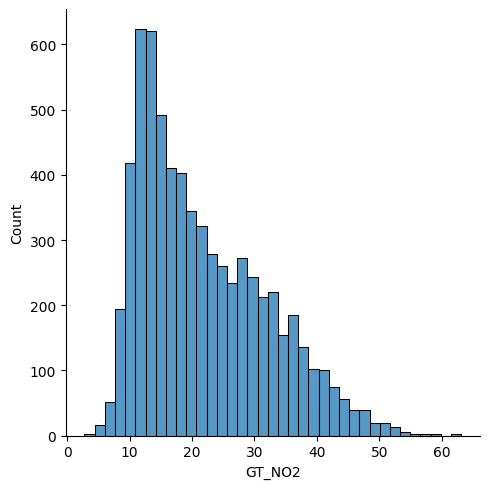

In [145]:
sns.displot(sub['GT_NO2'])

In [146]:
sub.to_csv('sub.csv',index = False)